In [3]:
## Fast Import
%load_ext autoreload
%autoreload 2
%matplotlib inline

import sys, os
import string
import pathlib
import time
import math, random
import pprint
import yaml
from collections import OrderedDict
from tqdm import tqdm

import cv2
import SimpleITK as sitk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

import torch, torchvision
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T
import albumentations as A

np.set_printoptions(precision=3)

# import rere base package & subpackages
curr_path = pathlib.Path(os.getcwd())
base_path = str(curr_path.parent.parent)
if base_path not in sys.path:
    sys.path.append(base_path)

import rere
from rere.utils import timers
from rere.utils.io import files, images2d, images3d
from rere.utils.images import visualize, np_image as nim_utils

from rere.data.samples import image

sw = timers.StopWatch()
test_images_d = {
    'gray': str(curr_path.parent / 'images' / 'gray_sample.png'),
    'rgb': str(curr_path.parent / 'images' / 'rgb_sample.jpg'),
    'bin': str(curr_path.parent / 'images' / 'bin_sample.png'),
    'bin3d': str(curr_path.parent / 'images' / 'bin3d_sample.nii.gz'),
    'gray3d': str(curr_path.parent / 'images' / 'gray3d_sample.nii.gz'),
    'gray3d_ni': str(curr_path.parent / 'images' / 'gray3d_sample_nonisotropic.nii.gz'),
    'bcv': str(curr_path.parent / 'images' / 'bcv.nii.gz'),
    'kits': str(curr_path.parent / 'images' / 'kits.nii.gz'),
    'liver': str(curr_path.parent / 'images' / 'liver_0.nii.gz'),
    'lung': str(curr_path.parent / 'images' / 'lung_038.nii.gz'),
    'pancreas': str(curr_path.parent / 'images' / 'pancreas_001.nii.gz'),
}

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
def print_sitk_info(sitk_im):
    print(f"Sitk Image Info:")
    print(sitk_im.GetSize())
    print(sitk_im.GetSpacing())
    print(sitk_im.GetDirection())
    print(sitk_im.GetOrigin())
    # print(sitk_im[200,200,15])

# Load sitk Images
gray3d_sitk = images3d.read_sitk3d(test_images_d['gray3d'])
mask3d_sitk = images3d.read_sitk3d(test_images_d['bin3d'])
gray3dni_sitk = images3d.read_sitk3d(test_images_d['gray3d_ni'])
gray2d_sitk = images2d.read_sitk2d_gray(test_images_d['gray'])
rgb2d_sitk = images2d.read_sitk2d_rgb(test_images_d['rgb'])
mask2d_sitk = images2d.read_sitk2d_gray(test_images_d['bin'])

bcv_sitk = images3d.read_sitk3d(test_images_d['bcv'])
kits_sitk = images3d.read_sitk3d(test_images_d['kits'])
liver_sitk = images3d.read_sitk3d(test_images_d['liver'])
lung_sitk = images3d.read_sitk3d(test_images_d['lung'])
pancreas_sitk = images3d.read_sitk3d(test_images_d['pancreas'])

# Load Image objects
gni_im = image.ScalarImage3D(
    test_images_d['gray3d_ni'], sitk.sitkInt64, permanent_load=False)
g_im = image.ScalarImage3D(
    test_images_d['gray3d'], sitk.sitkInt64, permanent_load=False)
m_im = image.ScalarMask3D(
    test_images_d['bin3d'], sitk.sitkUInt8, permanent_load=True)

In [13]:
def flip_affine_LPS_RAS(affine):
    assert affine.shape == (4, 4)
    flip_xy = np.diag((-1, -1, 1))
    flipped = np.zeros(affine.shape)
    flipped[:3, :3] = np.dot(flip_xy, affine[:3, :3])  # rot / scaling
    flipped[:3, 3] = np.dot(flip_xy, affine[:3, 3])  # translations
    return flipped

print(get_affine(gray3dni_sitk))  # in LPS+

import nibabel as nib
nib_im = nib.load(test_images_d['gray3d_ni'])
print(nib_im.affine)  # in RAS+
print(flip_affine_LPS_RAS(nib_im.affine))

print(np.dot(nib_im.affine, np.array([0, 0, 0, 1])))


[[-1.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  1.]] [401.215 401.215   0.   ] [0.785 0.785 7.5  ] [[1 0 0]
 [0 1 0]
 [0 0 1]]
[[ -0.785   0.      0.    401.215]
 [  0.     -0.785   0.    401.215]
 [  0.      0.      7.5     0.   ]
 [  0.      0.      0.      1.   ]]
[[   0.785    0.       0.    -401.215]
 [   0.       0.785    0.    -401.215]
 [   0.       0.       7.5      0.   ]
 [   0.       0.       0.       1.   ]]
[[ -0.785   0.      0.    401.215]
 [  0.     -0.785   0.    401.215]
 [  0.      0.      7.5     0.   ]
 [  0.      0.      0.      0.   ]]
[-401.215 -401.215    0.       1.   ]


Sitk Image Info:
(512, 512, 147)
(0.66796875, 0.66796875, 3.0)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.0, 0.0, 0.0)
147x512x512 int16 Image (max:2639 min:-1024)


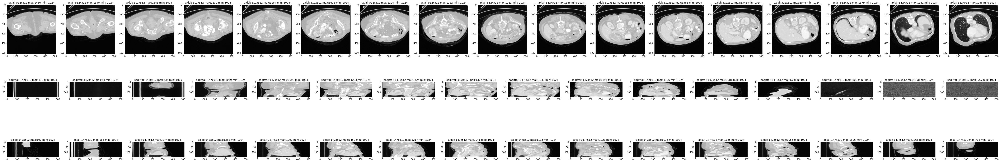

SystemExit: 1

In [5]:
### Test how to get direction to identity, origin to 0, and spacing to all 1.
def get_affine(sitk_im):
    ndim = sitk_im.GetDimension()
    affine = np.eye(ndim + 1)

    rotation = np.array(sitk_im.GetDirection()).reshape(3, 3)
    origin = np.array(sitk_im.GetOrigin())
    spacing = np.array(sitk_im.GetSpacing())
    flip_xy = np.diag((1, 1, 1))  # used to switch between LPS and RAS
    print()
    print(rotation, origin, spacing, flip_xy)

    M = np.dot(flip_xy, rotation) * spacing
    T = np.dot(flip_xy, origin)
    affine = np.eye(ndim + 1)
    affine[:ndim, :ndim] = M
    affine[:ndim, ndim] = T
    return affine

def resample(image, transform):
    # Output image Origin, Spacing, Size, Direction are taken from the reference
    # image in this call to Resample
    orig_size = image.GetSize()
    ndim = len(orig_size)
    orig_spacing = image.GetSpacing()    
    ref_spacing = min(orig_spacing)
    new_spacing = [ref_spacing] * ndim
    new_size = [int(round(orig_size[i] * orig_spacing[i] / ref_spacing)) \
                for i in range(ndim)]
    interpolator = sitk.sitkCosineWindowedSinc
    return sitk.Resample(image, new_size, transform,
                  interpolator, (0,0,0), (1,1,1), (1,0,0,0,1,0,0,0,1), 0,
                  image.GetPixelIDValue())
    return sitk.Resample(image, reference_image, transform,
                         interpolator, default_value)


def print_plot(sitk_im, isotropic=False):
    if isotropic:
        sitk_im = images3d.resample_sitk_isotropic(sitk_im, smooth=0)
    print_sitk_info(sitk_im)
    visualize.plot_3d_slices(sitk.GetArrayFromImage(sitk_im))

print_plot(bcv_sitk)
import sys; sys.exit(1)

print_sitk_info(gni_im.image)
visualize.plot_3d_slices(gni_im.get_numpy(isotropic=False).transpose())

print_sitk_info(g_im.image)
visualize.plot_3d_slices(g_im.get_numpy(isotropic=False).transpose())
import sys; sys.exit(1)
A = get_affine(gni_im.image)
print(A.dtype, A)

affine = sitk.AffineTransform(3)
affine.SetTranslation(A[:3, 3].ravel())
# print(affine)
affine = sitk.AffineTransform(affine)
affine.SetMatrix(A[:3,:3].ravel())
# print(affine)
new_image = resample(gni_im.image, affine)
print_sitk_info(new_image)
new_image_np = sitk.GetArrayFromImage(new_image)
visualize.plot_3d_slices(new_image_np)

ScalarImage3D (gid=0) w/ image: gray3d_sample_nonisotropic.nii.gz
  Given Format (type=<class 'str'>) 
  Type: 64-bit signed integer, Shape (512, 512, 31), Spacing (0.7851560115814209, 0.7851560115814209, 7.5) 
  Origin (401.2147216796875, 401.2147216796875, 0.0), Direction (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0) 
  Tot Mem = 248 bytes. 
Other Attributes: 
 {} 

ScalarImage3D (gid=1) w/ image: gray3d_sample.nii.gz
  Given Format (type=<class 'str'>) 
  Type: 64-bit signed integer, Shape (512, 512, 200), Spacing (1.0, 1.0, 1.0) 
  Origin (0.0, 0.0, 0.0), Direction (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0) 
  Tot Mem = 248 bytes. 
Other Attributes: 
 {} 

ScalarMask3D (gid=2) w/ image: bin3d_sample.nii.gz
  Given Format (type=<class 'str'>) 
  Type: 8-bit unsigned integer, Shape (512, 512, 200), Spacing (1.0, 1.0, 1.0) 
  Origin (0.0, 0.0, 0.0), Direction (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0) 
  Tot Mem = 248 bytes. 
Other Attributes: 
 {} 

200x512x512 int32 Imag

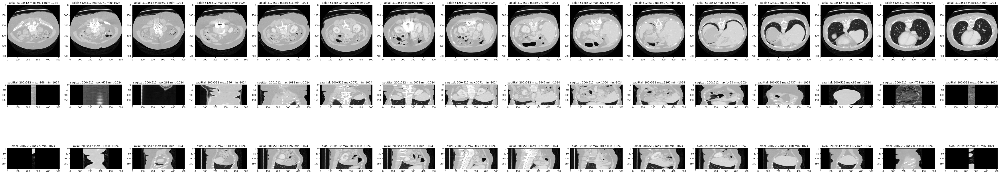

296x512x512 int32 Image (max:1157 min:-1024)


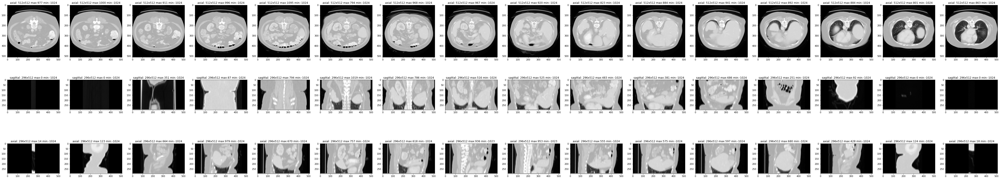

In [71]:
print(gni_im)
print(g_im)
print(m_im)



# g_im.plot()
# gni_im.plot()

In [70]:
g_np = g_im.get_numpy(isotropic=False)
gni_np = gni_im.get_numpy(isotropic=False)
print(g_np.shape, g_np.max(), g_np.min(), g_np[100,200,200])
print(gni_np.shape, gni_np.max(), gni_np.min(), gni_np[20,200,200])
gni_np = gni_im.get_numpy(isotropic=True)
print(gni_np.shape, gni_np.max(), gni_np.min(), gni_np[20,200,200])

(200, 512, 512) 3071 -1024 26
(31, 512, 512) 1166 -1024 -98
(296, 512, 512) 1157 -1024 82


In [ ]:
gni_np = gni_im.get_numpy(isotropic=True)
print(gni_np.shape, gni_np.max(), gni_np.min(), gni_np[20,200,200])

512x512x200 int32 Image (max:3071 min:-1024)


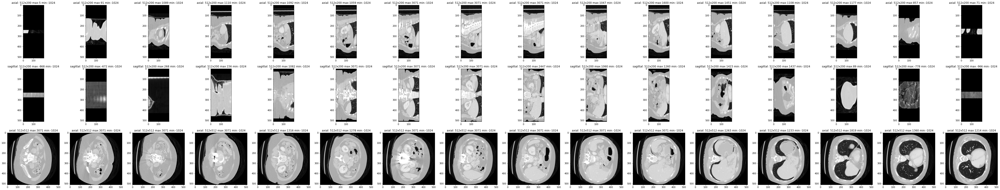

int32
StopWatch(default) took 0.16 sec
StopWatch(default) took 0.06 sec


0.055275917053222656

In [29]:
gi = gray3d_image1
gi.plot()

sw.tic()
data = gray3d_image1.get_numpy()
print(data.dtype)
sw.toc()

sw.tic()
d = data.astype(np.int32)
sw.toc()

In [29]:
sw.tic()
t = images3d.read_sitk3d(test_images_d['gray3d'])
sw.toc()

sw.tic()
images3d.read_sitk3d(test_images_d['bin3d'])
sw.toc()

sw.tic()
images2d.read_sitk2d_rgb(test_images_d['rgb'])
sw.toc()

print('hi'.__class__)
print(t.__class__)
print(isinstance(t, sitk.SimpleITK.Image))
print(sys.getsizeof(t))

sw.tic()
tt = sitk.GetArrayFromImage(t)
sw.toc()
print(sys.getsizeof(tt), tt.dtype)
print(t.GetPixelIDTypeAsString())

sw.tic()
sitk_type_str = t.GetPixelIDTypeAsString()
targ_type_str = sitk.GetPixelIDValueAsString(sitk.sitkInt16)
print(sitk_type_str, targ_type_str)
if sitk_type_str != targ_type_str:
    sitk.Cast(t, sitk.sitkInt16)
sw.toc()

StopWatch(default) took 0.94 sec
StopWatch(default) took 0.14 sec
StopWatch(default) took 0.01 sec
<class 'str'>
<class 'SimpleITK.SimpleITK.Image'>
True
48
StopWatch(default) took 0.02 sec
104857736 int16
16-bit signed integer
16-bit signed integer 16-bit signed integer
StopWatch(default) took 0.00 sec


0.00019097328186035156

# Visualize 2D & 3D Images

(541, 720, 3)
1


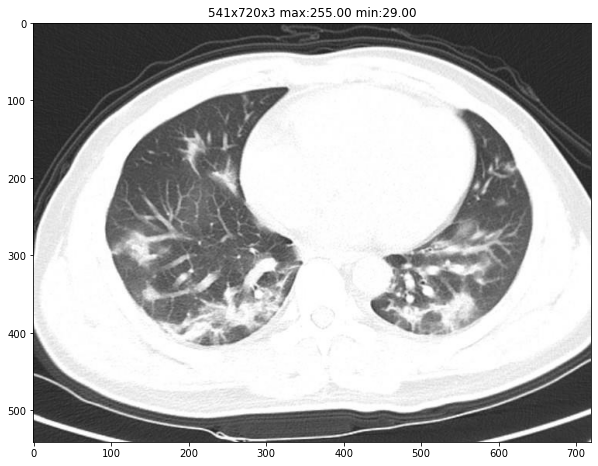

(541, 720, 1)
1


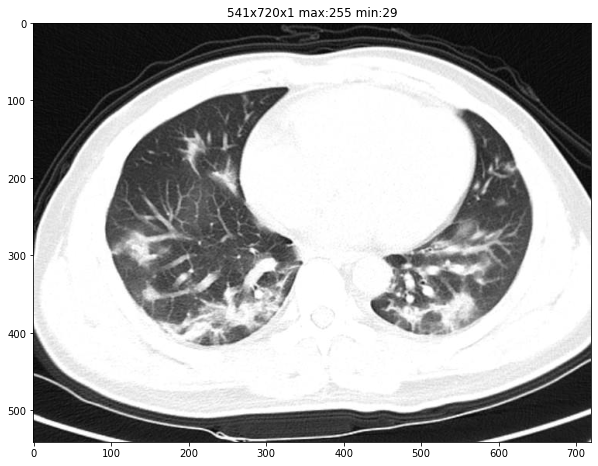

(1, 541, 720)
1


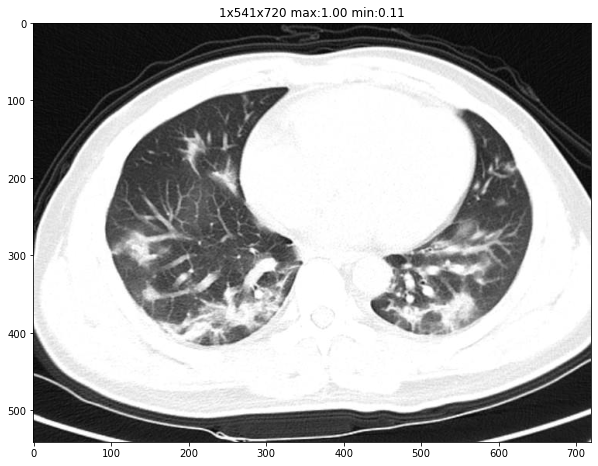

In [93]:
img = sitk.GetArrayFromImage(gray2d_sitk)
if img.ndim == 2:
    gray2d_np = img
    im_np1 = gray2d_np[:,:,None] * np.ones(3)[None, None, :]
    print(im_np1.shape)
    visualize.plot_2d_image(im_np1)
    im_np2 = np.expand_dims(gray2d_np, -1)
    print(im_np2.shape)
    visualize.plot_2d_image(im_np2)
    im_np3 = np.expand_dims(gray2d_np, 0)
    print(im_np3.shape)
    visualize.plot_2d_image(im_np3 / 255)
elif img.ndim == 3:
    print(img.shape)
    visualize.plot_2d_image(img)
    im_np = np.transpose(img, (-1, 0, 1))
    print(im_np.shape)
    visualize.plot_2d_image(im_np / 255)

In [77]:
n = np.array([[True, False], [False, True]])
print(n)
print((n.astype(np.uint8) * 255).dtype)

[[ True False]
 [False  True]]
uint8


1
541x720x3 max:255.00 min:29.00
2
3x767x1022 max:255 min:16
3
541x720x1 max:255 min:29
4
1x541x720 max:255 min:29
5
541x720x3 max:255.00 min:29.00
6
541x720x1 max:255 min:29
7
1x541x720 max:255 min:29
8
3x767x1022 max:255 min:16
9

10

11

12



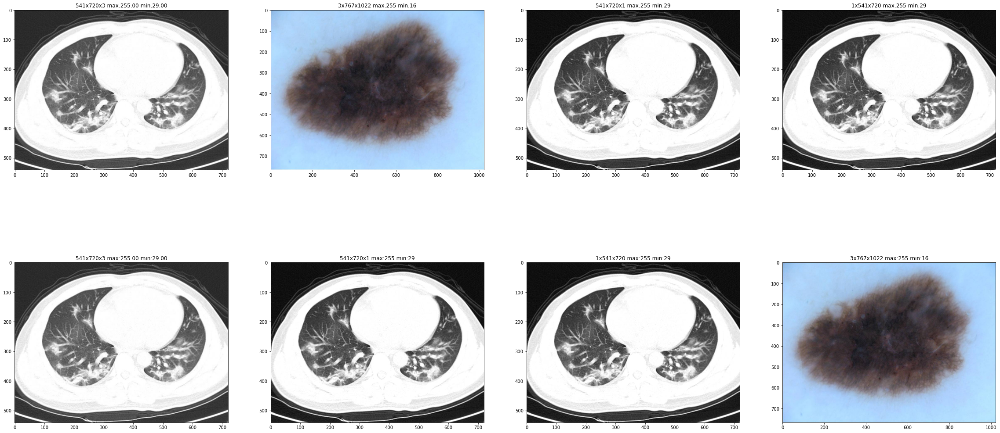

In [121]:
visualize.plot_2d_images([im_np1, im_np, im_np2, im_np3, im_np1, im_np2, im_np3, im_np], cols=4, titles=[]) # ['1', '2', '3'])

### Visualize 3D Image (+ Mask)

Resample 3D image (200, 512, 512) -> (200, 512, 512).
(-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0) (1.0, 1.0, 1.0)
Resample 3D image (200, 512, 512) -> (200, 512, 512).
200x512x512 int16 Image (max:3071 min:-1024)


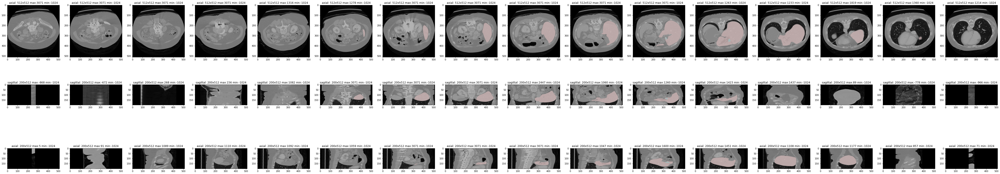

SystemExit: 1

In [4]:
gray3d_sitk_resample = images3d.resample_sitk_isotropic(gray3d_sitk,
                            interpolation='linear', smooth=2)
gray3d_np_resample = sitk.GetArrayFromImage(gray3d_sitk_resample)
gray3d_np = sitk.GetArrayFromImage(gray3d_sitk)
print(f"Resample 3D image {gray3d_np.shape} -> {gray3d_np_resample.shape}.")

mask3d_sitk_resample = images3d.resample_sitk_isotropic(mask3d_sitk, 
                            interpolation='nearest', smooth=2)
mask3d_np_resample = sitk.GetArrayFromImage(mask3d_sitk_resample)
mask3d_np = sitk.GetArrayFromImage(mask3d_sitk)
print(mask3d_sitk.GetDirection(), mask3d_sitk.GetSpacing())
print(f"Resample 3D image {mask3d_np.shape} -> {mask3d_np_resample.shape}.")

visualize.plot_3d_slices(gray3d_np_resample, mask=mask3d_np_resample)